In [1]:
include("../../src/WaterLily.jl")
WaterLily = Main.WaterLily;
using Plots; gr()
using StaticArrays
using JLD
using Images
using FFTW
using Statistics
using Interpolations
using DelimitedFiles
using LinearAlgebra

%%html
<style>
    .output {
        overflow: hidden;
    }
</style>

In [2]:
computationID = "SpectrumCal_256"


"SpectrumCal_256"

In [3]:
inside(a::AbstractArray) = CartesianIndices(map(ax->first(ax)+1:last(ax)-1,axes(a)))
@inline CI(a...) = CartesianIndex(a...)
"""
    δ(i,N::Int)
    δ(i,I::CartesianIndex{N}) where {N}

Return a CartesianIndex of dimension `N` which is one at index `i` and zero elsewhere.
"""
δ(i,::Val{N}) where N = CI(ntuple(j -> j==i ? 1 : 0, N))
δ(i,I::CartesianIndex{N}) where N = δ(i, Val{N}())
@inline inside_u(dims::NTuple{N}) where N = CartesianIndices((map(i->(2:i-1),dims)...,1:N))

inside_u (generic function with 1 method)

In [4]:
animAlpha(i,numFiles;y0 = 0.01) = 4*(1-y0)*(i/numFiles-0.5)^3 + (1+y0)/2
animAlpha(i,numFiles;y0 = 0.1) = (1-y0)*(i/numFiles)^2+y0
function movmean(x::Vector{Float64}, m::Integer)
    """Compute off-line moving average
    
    Parameters
    ----------
    x (Array):
        One-dimensional array with time-series. size(x)=(N,)
    m (int):
        Length of the window where the mean is computed
    
    Returns
    -------
    y (Array):
        Array with moving mean values. size(y)=(N-m+1)    
    """

    N = length(x)
    y = fill(0., N-m+1)

    y[1] = sum(x[1:m])/m
    for i in 2:N-m+1
        @views y[i] = y[i-1] + (x[i+m-1]-x[i-1])/m
    end
    return y
end

movmean (generic function with 1 method)

In [5]:
function InterpolOmega(xOrig,omega)
    x = xOrig .+ 2.0
    floorx = floor.(x)
    I = CartesianIndex(Int.(floorx)...)
    residual = x.-floorx
    N = length(I)
    s = 0.0
    for i ∈ N
        s += omega[I]*(1-residual[i]) + omega[I+δ(i,I)]*residual[i]
    end
    return s/N
end

function getCylUCoord(rList, thetaList, zList, center)
    return permutedims(
        stack(
            [[a*cos(b)+center[1], a*sin(b)+center[2], c] for a in rList, b in thetaList, c in zList]
        ), 
        [2,3,4,1]
    )
end

function getCylUCylCoord(rList, thetaList, zList, center)
    return [a for a in rList, b in thetaList, c in zList], [b for a in rList, b in thetaList, c in zList], [c for a in rList, b in thetaList, c in zList]
end

function InterpolCylU!(uCylAtCarte, uCylAtCyl, xCylAtCyl)
    x = xCylAtCyl
    carteSize = size(uCylAtCarte)[1:3]
    uSize = size(xCylAtCyl)
    N = last(uSize)
    insize = Base.front(uSize)
    s = Vector([0.0,0.0,0.0])
    for ixyz∈CartesianIndices(insize)
        regularizedCoord = mod.(x[ixyz,:], carteSize)
        floorCoord = floor.(regularizedCoord.+0.5) .- 0.5
        aaa = deepcopy(floorCoord)
        residual = regularizedCoord.-floorCoord
        floorCoord = mod.(floorCoord, carteSize)
        I = CartesianIndex(Int.(round.(floorCoord.+0.5))...)
        s .= 0.0
        for i ∈ N
            Iup = CartesianIndex(mod.((I+δ(i,I)).I .-1, carteSize) .+1)
            s += uCylAtCarte[I,:]*(1-residual[i]) + uCylAtCarte[Iup,:]*residual[i]
        end
        uCylAtCyl[ixyz,:] .= s/N
    end
end

function InterpolCylUPkg!(uOriginalAll, uCylAtCyl, xCylAtCyl)
    x = xCylAtCyl
    carteSize = size(uOriginalAll)[1:3] .- 2
    itpUx = interpolate(uOriginalAll[:,:,:,1], BSpline(Linear()))
    itpUy = interpolate(uOriginalAll[:,:,:,2], BSpline(Linear()))
    itpUz = interpolate(uOriginalAll[:,:,:,3], BSpline(Linear()))
    uSize = size(xCylAtCyl)
    N = last(uSize)
    insize = Base.front(uSize)
    for ixyz∈CartesianIndices(insize)
        regularizedCoord = mod.(x[ixyz,:], carteSize) .+ 1.5
        uCylAtCyl[ixyz,1] = itpUx(regularizedCoord...)
        uCylAtCyl[ixyz,2] = itpUy(regularizedCoord...)
        uCylAtCyl[ixyz,3] = itpUz(regularizedCoord...)
    end
end

InterpolCylUPkg! (generic function with 1 method)

In [6]:
function ComputeVorticity!(u, vortVec)
    for I∈inside(vortVec[:,:,:,1]) 
        vortVec[I,:] = WaterLily.ω(I,u)
    end
    WaterLily.BCPerVec!(vortVec)
end

function ComputeEntrophySpectrum!(vortVec, vortSpectrum)
    vortSpectrum .= 0.0
    magSlice = dropdims(Statistics.mean(vortVec, dims=3),dims=3)
    gridSize = size(magSlice)[1:2]
    ω̂ = magSlice*0im
    for i ∈ 1:3
        ω̂[:,:,i] = fft(magSlice[:,:,i])/prod(gridSize);
    end
    lx = fftfreq(gridSize[1],gridSize[1])
    ly = fftfreq(gridSize[2],gridSize[2])
    count = vortSpectrum*0
    for I in CartesianIndices(gridSize)
        l = sqrt(lx[I[1]]^2+ly[I[2]]^2)
        (l<0.5) && continue
        vortSpectrum[Int(round(l))] += sum(abs2.(ω̂[I,:]))
        count[Int(round(l))] += 1
    end
    vortSpectrum .*= (1:size(vortSpectrum)[1]).^2 ./ count
    vortSpectrum .+=1e-14
end

function Compute3DSpectrum!(vortVec, vortSpectrum)
    vortSpectrum .= 0.0
    gridSize = size(vortVec)
    ω̂ = vortVec*0im
    for i ∈ 1:3
        ω̂[:,:,:,i] = fft(vortVec[:,:,:,i])/prod(gridSize);
    end
    lx = fftfreq(gridSize[1],gridSize[1])
    ly = fftfreq(gridSize[2],gridSize[2])
    lz = fftfreq(gridSize[3],gridSize[3])
    count = vortSpectrum*0
    for I in CartesianIndices(gridSize)
        l = sqrt(lx[I[1]]^2+ly[I[2]]^2+lz[I[3]]^2)
        (l<0.5) && continue
        vortSpectrum[Int(round(l))] += sum(abs2.(ω̂[I,:]))
        count[Int(round(l))] += 1
    end
    kClamp = clamp.(1:size(vortSpectrum)[1],1,max(1,min(maximum(lx),maximum(ly),maximum(lz))))
    vortSpectrum .*= (kClamp).^2 ./ count
    vortSpectrum .+=1e-14
end

function ComputeSpectrumInAxialDirection!(uCylFlucAtCyl, rList, flucSpectrum)
    flucSpectrum .= 0.0
    cylGridSize = size(uCylFlucAtCyl)[1:3]
    lz = fftfreq(cylGridSize[3],cylGridSize[3])
    for I in CartesianIndices(cylGridSize[1:2])
        extractedSlice = uCylFlucAtCyl[I,:,:]
        ω̂ = extractedSlice*0im
        for i ∈ 1:3
            ω̂[:,i] = fft(extractedSlice[:,i])/prod(cylGridSize[3]);
        end
        fftval = sum(abs2.(ω̂),dims=[2])[:,1]
        midpoint = cylGridSize[3]÷2
        vortSpectrum = flucSpectrum[:,I]*0
        vortSpectrum = fftval[2:midpoint+1]+fftval[end:-1:midpoint+1]
        flucSpectrum[:,I] = vortSpectrum
    end
end

function ComputeSpectrumFromCylindrical!(uCylFlucAtCyl, rList, axialLength, flucSpectrum, counts)
    flucSpectrum .= 0.0
    cylGridSize = size(uCylFlucAtCyl)[1:3]
    for iRSlice ∈ 1:cylGridSize[1]
        extractedSlice = uCylFlucAtCyl[iRSlice,:,:,:]
        ω̂ = extractedSlice*0im
        for i ∈ 1:3
            ω̂[:,:,i] = fft(extractedSlice[:,:,i])/prod(cylGridSize[2:3]);
        end
        ltheta = fftfreq(cylGridSize[2],rList[iRSlice]*2pi)
        lz = fftfreq(cylGridSize[3],axialLength)
        count = flucSpectrum[:,iRSlice]*0
        vortSpectrum = flucSpectrum[:,iRSlice]*0
        for I in CartesianIndices(cylGridSize[2:3])
            l = sqrt(ltheta[I[1]]^2+lz[I[2]]^2)
            (l<0.5) && continue
            vortSpectrum[Int(round(l))] += sum(abs2.(ω̂[I,:]))
            #vortSpectrum[Int(round(l))] += abs2.(ω̂[I,2])
            count[Int(round(l))] += 1
        end
        clamp!(count,1,Inf)
        kClamp = clamp.(1:size(vortSpectrum)[1],1,max(1,min(maximum(ltheta),maximum(lz))))
        vortSpectrum .*= kClamp.^1 ./ count
        vortSpectrum .+= 1e-16
        flucSpectrum[:,iRSlice] = vortSpectrum
        counts[:,iRSlice] = (1:size(vortSpectrum)[1]).^1 ./ count
    end
end

function ComputeSpectrumFromCylindricalOneD!(uCylFlucAtCyl, rList, axialLength, flucSpectrum, counts)
    flucSpectrum .= 0.0
    cylGridSize = size(uCylFlucAtCyl)[1:2]
    uCylFlucAtCylAvgAxial = dropdims(Statistics.mean(uCylFlucAtCyl, dims=[3]), dims=3)
    for iRSlice ∈ 1:cylGridSize[1]
        extractedSlice = uCylFlucAtCylAvgAxial[iRSlice,:,:]
        ω̂ = extractedSlice*0im
        for i ∈ 1:3
            ω̂[:,i] = fft(extractedSlice[:,i])/prod(cylGridSize[1]);
        end
        ltheta = fftfreq(cylGridSize[2],rList[iRSlice]*2pi)
        count = flucSpectrum[:,iRSlice]*0
        vortSpectrum = flucSpectrum[:,iRSlice]*0
        for I in CartesianIndices((cylGridSize[1],))
            l = sqrt(ltheta[I[1]]^2)
            (l<0.5) && continue
            vortSpectrum[Int(round(l))] += sum(abs2.(ω̂[I,:]))
            #vortSpectrum[Int(round(l))] += abs2.(ω̂[I,2])
            count[Int(round(l))] += 1
        end
        clamp!(count,1,Inf)
        vortSpectrum .*= (1:size(vortSpectrum)[1]).^2 ./ count
        clamp!(vortSpectrum,1e-16,Inf)
        flucSpectrum[:,iRSlice] = vortSpectrum
        counts[:,iRSlice] = count
    end
end

function StaggerToCollocateVel!(u, uInside)
    uInside .= 0.0
    uInside[:,:,:,1] = 0.5*(u[2:end-1,2:end-1,2:end-1,1]+u[3:end,2:end-1,2:end-1,1])
    uInside[:,:,:,2] = 0.5*(u[2:end-1,2:end-1,2:end-1,2]+u[2:end-1,3:end,2:end-1,2])
    uInside[:,:,:,3] = 0.5*(u[2:end-1,2:end-1,2:end-1,3]+u[2:end-1,2:end-1,3:end,3])
end

function VertexToPointVor!(ω, ωInside)
    ωInside .= 0.0
    sizeOrig = size(ω)[1:3]
    Iprep = ntuple(i -> 2:sizeOrig[i]-1,3)
    for i in 0:1, j in 0:1, k in 0:1
        ωInside .+= ω[CartesianIndices((Iprep[1].+i, Iprep[2].+j,Iprep[3].+k)),:]
    end
    ωInside ./= 8.0
end

function ToCylindricalVel!(uInside, uCyl, rMat, CosThetaMat, SinThetaMat)
    uCyl .= 0
    u,v,w = uInside[:,:,:,1],uInside[:,:,:,2],uInside[:,:,:,3]
    uCyl[:,:,:,1] = u .* CosThetaMat .+ v .* SinThetaMat
    uCyl[:,:,:,2] =-u .* SinThetaMat .+ v .* CosThetaMat
    uCyl[:,:,:,3] = w*1.0
end

function ComputeMeanU!(uCyl, uMeanRadial, uMeanAzimuthal, uMeanAxial, rMat, rGaussianMat)
    uCylFlat = Statistics.mean(uCyl,dims=3)
    gridSize = size(uCylFlat)
    uMeanRadial .= 0
    uMeanAzimuthal .= 0
    uMeanAxial .= 0
    sumR = similar(uMeanAxial)*0
    for I in CartesianIndices(gridSize[1:3])
        loc = Int(round(rMat[I]))
        uMeanRadial[loc] += uCylFlat[I,1]*rGaussianMat[I]
        uMeanAzimuthal[loc] += uCylFlat[I,2]*rGaussianMat[I]
        uMeanAxial[loc] += uCylFlat[I,3]*rGaussianMat[I]
        sumR[loc] += rGaussianMat[I]
    end
    uMeanRadial ./= sumR
    uMeanAzimuthal ./= sumR
    uMeanAxial ./= sumR
end

function ProjectCylMeanToCartesian!(uMeanFromCyl, uMeanRadial, uMeanAzimuthal, uMeanAxial, rMat, rGaussianMat)
    r = 1 : (size(uMeanRadial)[1])
    uRadialInterpolator = linear_interpolation(r, uMeanRadial, extrapolation_bc=Interpolations.Line())
    uAzimuthalInterpolator = linear_interpolation(r, uMeanAzimuthal, extrapolation_bc=Interpolations.Line())
    uAxialInterpolator = linear_interpolation(r, uMeanAxial, extrapolation_bc=Interpolations.Line())
    uMeanFromCyl[:,:,1,1] = uRadialInterpolator.(rMat)
    uMeanFromCyl[:,:,1,2] = uAzimuthalInterpolator.(rMat)
    uMeanFromCyl[:,:,1,3] = uAxialInterpolator.(rMat)
end

function ComputeFluc!(uMeanFromCyl, uCyl, uFluc)
    uFluc .= uCyl.-uMeanFromCyl
end

function ComputePlanarTKE!(uFluc)
    return dropdims(Statistics.mean(sum(uFluc.^2,dims=4),dims=3),dims=(3,4))*0.5
end

function Computeλ₂!(u, lambdatwo, dat, UScale, LScale)  # compute log10(-λ₂), where λ₂ has already been normalized by the prescribed length and time scales
    for I∈inside(lambdatwo)
        lambdatwo[I] = log10(max(1e-6,-WaterLily.λ₂(I,u)*LScale/UScale))
    end
    copyto!(dat,lambdatwo[inside(lambdatwo)])
end

Computeλ₂! (generic function with 1 method)

In [7]:
A,B,C = 1,1,1
a,b,c = (10,-5,-5).*2pi ./256
u(x,y,z) = @. A*cos(a*x)*sin(b*y)*sin(c*z)
v(x,y,z) = @. B*sin(a*x)*cos(b*y)*sin(c*z)
w(x,y,z) = @. C*sin(a*x)*sin(b*y)*cos(c*z)

xxx = reshape((1:256) .-0.5, 256,1,1)
yyy = reshape((1:256) .-0.5, 1,256,1)
zzz = reshape((1:256) .-0.5, 1,1,256)

pow=8
uvw = zeros(258,258,258,3);


In [8]:
uvw[2:end-1,2:end-1,2:end-1,1] = reshape(readdlm("cbc_n256_m10000.txt/u_n256_m10000_cbc_float.txt", '\t', Float64, '\n', skipstart=2),(2^pow,2^pow,2^pow));
uvw[2:end-1,2:end-1,2:end-1,2] = reshape(readdlm("cbc_n256_m10000.txt/v_n256_m10000_cbc_float.txt", '\t', Float64, '\n', skipstart=2),(2^pow,2^pow,2^pow));
uvw[2:end-1,2:end-1,2:end-1,3] = reshape(readdlm("cbc_n256_m10000.txt/w_n256_m10000_cbc_float.txt", '\t', Float64, '\n', skipstart=2),(2^pow,2^pow,2^pow));
WaterLily.BCPerVec!(uvw)

In [9]:

# uvw[2:end-1,2:end-1,2:end-1,1] = reshape(readdlm("karman_n256_m10000.txt/u_n256_m10000_karman_float.txt", '\t', Float64, '\n', skipstart=2),(2^pow,2^pow,2^pow));
# uvw[2:end-1,2:end-1,2:end-1,2] = reshape(readdlm("karman_n256_m10000.txt/v_n256_m10000_karman_float.txt", '\t', Float64, '\n', skipstart=2),(2^pow,2^pow,2^pow));
# uvw[2:end-1,2:end-1,2:end-1,3] = reshape(readdlm("karman_n256_m10000.txt/w_n256_m10000_karman_float.txt", '\t', Float64, '\n', skipstart=2),(2^pow,2^pow,2^pow));


In [10]:
# uvw[2:end-1,2:end-1,2:end-1,1] = u(xxx,yyy,zzz);
# uvw[2:end-1,2:end-1,2:end-1,2] = v(xxx,yyy,zzz);
# uvw[2:end-1,2:end-1,2:end-1,3] = w(xxx,yyy,zzz);
# WaterLily.BCPerVec!(uvw)

In [11]:
WaterLily.BCPerVec!(uvw)

In [12]:
# read an example file to get size information

@time uOriginAll = uvw
gridSize = ntuple(i -> size(uOriginAll)[i]-2 ,3)
cylGridSize = ntuple(i -> i==1 ? Int(round(minimum(gridSize[1:2])/2-2)) : gridSize[i], 3)

UScale = 4
LScale = gridSize[1]/8
TScale = LScale/UScale

  0.000009 seconds (1 allocation: 64 bytes)


8.0

In [13]:
# make coordinate
xCoord = reshape(Array((1:gridSize[1]).-0.5 .-gridSize[1]/2), gridSize[1], 1, 1)
yCoord = reshape(Array((1:gridSize[2]).-0.5 .-gridSize[2]/2), 1, gridSize[2], 1)
rMat = sqrt.(xCoord.^2 .+ yCoord.^2)
thetaMat = atan.(yCoord,xCoord)
CosThetaMat = cos.(thetaMat)
SinThetaMat = sin.(thetaMat)
#
rList = (1:cylGridSize[1]) .- 0.5
thetaList = (1:cylGridSize[2])/cylGridSize[2]*2*pi
zList = (1:cylGridSize[3]) .- 0.5
xCylAtCyl = getCylUCoord(rList, thetaList, zList, Array([gridSize[1:2]...])/2)
rMatAtCyl, thetaMatAtCyl, zMatAtCyl = getCylUCylCoord(rList, thetaList, zList, Array([gridSize[1:2]...])/2)
CosThetaMatAtCyl = cos.(thetaMatAtCyl)
SinThetaMatAtCyl = sin.(thetaMatAtCyl)
# 
rRoundMat = Int.(round.(rMat))
rDiffMat = rMat .- rRoundMat
rGaussianMat = exp.(-0.2*rDiffMat.^2)

# construct storage array when processing
radialDirectionSize = Int(round(maximum(rMat)))
spectrumLength = Int(round(sqrt(gridSize[3]^2+(2*pi*maximum(rList))^2)/2))
#
uOriginAllCollocated = similar(uOriginAll)
uInside = zeros(gridSize...,3)
uCyl = similar(uInside)
uFluc = similar(uInside)
uMeanFromCyl = zeros(gridSize[1:2]...,1,3)
uCylAtCyl = zeros(cylGridSize...,3)
ωCylAtCyl = zeros(cylGridSize...,3)
uCarteAtCyl = zeros(cylGridSize...,3)
vortVec = zeros(size(uOriginAll))
vortVecInside = zeros(size(uInside))
lambda2 = zeros(size(uOriginAll)[1:3])
lambda2Data = zeros(gridSize)
#tkePlane = zeros(gridSize[1:2])
#
uMeanRadial = zeros(cylGridSize[1])
uMeanAzimuthal = zeros(cylGridSize[1])
uMeanAxial = zeros(cylGridSize[1])
vortSpectrum = zeros(spectrumLength)
flucSpectrum = zeros(spectrumLength,cylGridSize[1]);
axialFlucSpectrum = zeros(cylGridSize[3]÷2,cylGridSize[1:2]...);
axialFlucSpectrumOnlyZ = zeros(gridSize[3]÷2,gridSize[1:2]...);
counts = zeros(spectrumLength,cylGridSize[1]);



In [14]:
# processing the velocity data
@time ComputeVorticity!(uOriginAll, vortVec);
vortVec *= TScale;
VertexToPointVor!(vortVec,vortVecInside)
vorticityMag = sqrt.(dropdims(sum(vortVec.^2, dims=4), dims=4))
# ComputeEntrophySpectrum!(vortVec[2:end-1,2:end-1,2:end-1,:], vortSpectrum)
# vortSpectrum *= 2pi*(2pi*LScale/gridSize[1])
@time StaggerToCollocateVel!(uOriginAll, uInside);


  0.800346 seconds (421.95 k allocations: 159.009 MiB, 15.68% compilation time)


  0.950500 seconds (250.08 k allocations: 1.516 GiB, 12.07% gc time, 13.31% compilation time)


In [15]:

uOriginAllCollocated[2:end-1,2:end-1,2:end-1,:] = uInside
WaterLily.BCPerVec!(uOriginAllCollocated)
#@time InterpolCylU!(uInside, uCarteAtCyl, xCylAtCyl);
@time InterpolCylUPkg!(uOriginAllCollocated, uCarteAtCyl, xCylAtCyl)
@time ToCylindricalVel!(uCarteAtCyl, uCylAtCyl, rMatAtCyl, CosThetaMatAtCyl, SinThetaMatAtCyl);
meanCylUatCyl = Statistics.mean(uCylAtCyl, dims=[2,3]);
flucCylUatCyl = uCylAtCyl .- meanCylUatCyl;
meanFlucCylUatCyl = Statistics.mean(flucCylUatCyl, dims=[2,3]);


  3.871337 seconds (141.02 M allocations: 4.624 GiB, 7.58% gc time, 5.42% compilation time)


  0.415934 seconds (397.48 k allocations: 466.550 MiB, 40.36% compilation time)


In [16]:

uOriginAllCollocated[2:end-1,2:end-1,2:end-1,:] = vortVecInside
WaterLily.BCPerVec!(uOriginAllCollocated)
@time InterpolCylUPkg!(uOriginAllCollocated, uCarteAtCyl, xCylAtCyl)
@time ToCylindricalVel!(uCarteAtCyl, ωCylAtCyl, rMatAtCyl, CosThetaMatAtCyl, SinThetaMatAtCyl);
meanCylωatCyl = Statistics.mean(ωCylAtCyl, dims=[2,3]);
flucCylωatCyl = ωCylAtCyl .- meanCylωatCyl;
meanFlucCylωatCyl = Statistics.mean(flucCylωatCyl, dims=[2,3]);
# ComputeMeanU!(uCyl, uMeanRadial, uMeanAzimuthal, uMeanAxial, rMat, rGaussianMat)
angularMomentum = sum((rList.^2 .* meanCylUatCyl[:,:,:,2])[1:120])
axialMomentum = sum((rList .* meanCylUatCyl[:,:,:,3])[1:120])

  3.221066 seconds (140.38 M allocations: 4.582 GiB, 7.20% gc time)


  0.241354 seconds (17 allocations: 441.001 MiB)


-8.503684671700544

In [17]:
meanFlucCylUatCyl = Statistics.mean(flucCylUatCyl, dims=[2,3]);


In [18]:
@time ComputeSpectrumFromCylindrical!(flucCylUatCyl, rList, gridSize[3], flucSpectrum,counts);
# ProjectCylMeanToCartesian!(uMeanFromCyl, uMeanRadial, uMeanAzimuthal, uMeanAxial, rMat, rGaussianMat)
# ComputeFluc!(uMeanFromCyl, uCyl, uFluc)
# ComputeEntrophySpectrum!(uFluc, flucSpectrum)
flucSpectrum *= 2pi*(2pi*LScale/gridSize[1]);
# tkePlane = ComputePlanarTKE!(uFluc)
# # compute kinetic energy
# tke = 0.5*sum(uFluc.^2)/prod(gridSize)
# mke = 0.5*sum(uMeanFromCyl.^2)*gridSize[3]/prod(gridSize)
uspec = zeros(225)
Compute3DSpectrum!(uInside,uspec)
@time ComputeSpectrumInAxialDirection!(flucCylUatCyl, rList, axialFlucSpectrum)

@time ComputeSpectrumInAxialDirection!(uInside, rList, axialFlucSpectrumOnlyZ)

# make some plots
# plt = Plots.contourf((0:gridSize[3]-1)/LScale.-4, (0:gridSize[1]-1)/LScale.-4, vorticityMag[2:end-1,Int(gridSize[2]/2)+1,2:end-1], linewidth = 0, color=:bilbao, levels=40, clim=(0,2), aspect_ratio=:equal, xlim=[0.0,gridSize[1]]/LScale.-4, ylim=[0.0,gridSize[2]]/LScale.-4)
a = 1

  2.110648 seconds (17.56 M allocations: 3.393 GiB, 9.21% gc time, 19.05% compilation time)


  1.844489 seconds (1.75 M allocations: 2.448 GiB, 10.81% gc time, 13.19% compilation time)


  2.698822 seconds (2.56 M allocations: 4.908 GiB, 6.18% gc time)


1

In [19]:
function oneD2TwoD(a)
    return [
        a[1] a[4] a[6]; 
        a[4] a[2] a[5]; 
        a[6] a[5] a[3]
    ]
end

function sorteigen(evals::Vector{T},evecs::Matrix{T}) where {T<:Real}
    p = sortperm(evals,rev=true)
    evals[p], evecs[:, p]
end

function uuAlongR2Eigvals(uuAlongR)
    tkeAlongR = 0.5*sum(uuAlongR[:,1:3], dims=2)
    anIsoAlongR = uuAlongR ./(2tkeAlongR)
    anIsoAlongR[:,1:3] .-= 1/3
    eigvalsAlongR = zeros(cylGridSize[1],3)
    eigvecsAlongR = zeros(cylGridSize[1],3,3)
    for iR in 1:cylGridSize[1]
        AA = oneD2TwoD(anIsoAlongR[iR,:])
        F = eigen(AA)
        eigvalsAlongR[iR,:],eigvecsAlongR[iR,:,:] = sorteigen(F.values, F.vectors)
    end
    return eigvalsAlongR,eigvecsAlongR
end

function EigenvecsOnPolarCoord(evecsAlongR)
    er,eTheta = evecsAlongR[:,1], evecsAlongR[:,2]
    return sqrt.(er.^2+eTheta.^2), atan.(eTheta./er)
end

function EigVals2LumleyCoord(eigvalsAlongR)
    l1,l2,l3 = eigvalsAlongR[:,1],eigvalsAlongR[:,2],eigvalsAlongR[:,3]
    LumleyCoord = zeros(cylGridSize[1],2)

    II = l1.^2 .+ l1.*l2 .+ l2.^2
    III = -l1.*l2 .* (l1 .+ l2);

    LumleyCoord[:,1] = cbrt.(III/2);
    LumleyCoord[:,2] = sqrt.(II/3);
    return LumleyCoord
end

function EigVals2BarycentricCoord(eigvalsAlongR,eigvecsAlongR)
    l1,l2,l3 = eigvalsAlongR[:,1],eigvalsAlongR[:,2],eigvalsAlongR[:,3]
    r1,t1 = EigenvecsOnPolarCoord(eigvecsAlongR[:,:,1])
    r3,t3 = EigenvecsOnPolarCoord(eigvecsAlongR[:,:,3])
    symbol = Array{Symbol}(undef,size(l1)...)
    symbol .= :circle

    BarycentricCoord = zeros(cylGridSize[1],2)

    C1c = l1 .- l2
    C2c = 2(l2 .- l3)
    C3c = 3l3 .+ 1

    N1c = C1c .> C2c
    N2c = BitArray(1 .- N1c)

    r = N1c.*r1 + N2c.*r3
    t = N1c.*t1 + N2c.*t3

    symbol[N1c] .= :square

    BarycentricCoord[:,1] = C1c+0.5C3c
    BarycentricCoord[:,2] = sqrt(3)/2*C3c

    return BarycentricCoord, r, t, symbol
end

EigVals2BarycentricCoord (generic function with 1 method)

In [20]:
anIsoAlongR = zeros(cylGridSize[1],6)

for iii in 1:3
    anIsoAlongR[:,iii] = Statistics.mean(flucCylUatCyl[:,:,:,iii].*flucCylUatCyl[:,:,:,iii],dims=[2,3])
end
anIsoAlongR[:,4] = Statistics.mean(flucCylUatCyl[:,:,:,1].*flucCylUatCyl[:,:,:,2],dims=[2,3])
anIsoAlongR[:,5] = Statistics.mean(flucCylUatCyl[:,:,:,2].*flucCylUatCyl[:,:,:,3],dims=[2,3])
anIsoAlongR[:,6] = Statistics.mean(flucCylUatCyl[:,:,:,3].*flucCylUatCyl[:,:,:,1],dims=[2,3]);

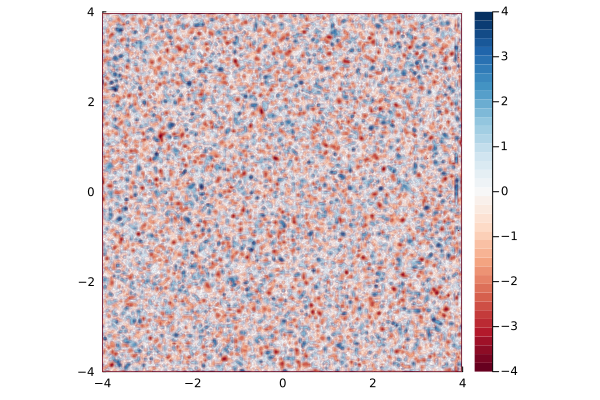

In [21]:
plt = Plots.contourf((0:gridSize[3]-1)/LScale.-4, (0:gridSize[1]-1)/LScale.-4, vortVec[2:end-1,Int(gridSize[2]/2)+1,2:end-1,2], linewidth = 0, color=:RdBu, levels=40, clim=(-4,4), aspect_ratio=:equal, xlim=[0.0,gridSize[1]]/LScale.-4, ylim=[0.0,gridSize[2]]/LScale.-4)

In [22]:
plt = Plots.contourf(
    (0:gridSize[3]-1)/LScale.-4, (0:gridSize[1]-1)/LScale.-4, 
    sqrt.(sum(uInside[:,:,1,:].^2, dims=[3])[:,:,1]), 
    linewidth = 0, color=:turbid, levels=40, clim=(0,1), aspect_ratio=:equal, xlim=[0.0,gridSize[1]]/LScale.-4, ylim=[0.0,gridSize[2]]/LScale.-4
)
Plots.savefig(computationID*"_"*"demoZSlice.png")

"/home/tyhuang/Documents/Github/WaterLily.jl/test/TYTest/SpectrumCal_256_demoZSlice.png"

In [23]:
plt = Plots.contourf(
    (0:gridSize[3]-1)/LScale*2*pi/gridSize[3]*63, (0:gridSize[1]-1)/LScale .-4, 
    sqrt.(sum(uCylAtCyl[63,:,:,:].^2, dims=[3])[:,:,1])', 
    linewidth = 0, color=:turbid, levels=40, clim=(0,1), aspect_ratio=:equal, xlim=[0,12.3], ylim=[0.0,gridSize[2]]/LScale.-4
)
Plots.savefig(computationID*"_"*"demoThetaSlice.png")

"/home/tyhuang/Documents/Github/WaterLily.jl/test/TYTest/SpectrumCal_256_demoThetaSlice.png"

In [24]:
uruz = flucCylUatCyl[:,:,:,1].*flucCylUatCyl[:,:,:,3]
#uruz = flucCylUatCyl[:,:,:,1].^2 - (flucCylUatCyl[:,:,:,2].^2 + flucCylUatCyl[:,:,:,3].^2)
plt = Plots.contourf(0:255,0:127,flucCylωatCyl[1:128,64,:,2]/2, linewidth = 0, color=:RdBu, levels=40, aspect_ratio=:equal)
plt = Plots.contourf!(0:255,-127:0,reverse(uruz[1:128,64,:]/0.1,dims=1), linewidth = 0, color=:RdBu, levels=40, aspect_ratio=:equal, clim=(-1,1))

BoundsError: BoundsError: attempt to access 126×256×256×3 Array{Float64, 4} at index [1:128, 64, 1:256, 2]

┌ Info: Saved animation to /home/tyhuang/Documents/Github/WaterLily.jl/test/TYTest/SpectrumCal_256_qVortexTKESpecAlongR.gif
└ @ Plots /home/tyhuang/.julia/packages/Plots/3BCH5/src/animation.jl:156


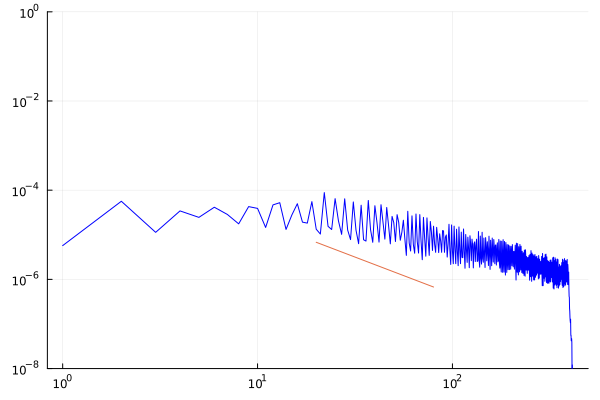

In [25]:
a = Animation()
Plots.plot()
xlll = 20:80
Plots.plot!(xlll, 0.001xlll.^(-5/3))
for i ∈ 1:size(flucSpectrum)[2]
    plt = Plots.plot(movmean(flucSpectrum[:,i],1)./rList[i],color=:blue,legend = false,xscale=:log10,yscale=:log10,ylimit=(1e-8,1),alpha=1)#rList[i] animAlpha(i,size(flucSpectrum)[2])
    plt = Plots.plot!(xlll, 0.001xlll.^(-5/3))
    frame(a,plt)
end
Plots.plot!(xscale=:log10,yscale=:log10)
gif(a, computationID*"_"*"qVortexTKESpecAlongR.gif")
Plots.plot!()

In [26]:
mmmm= sqrt(Statistics.mean(uInside.^2))

0.22305391792376236

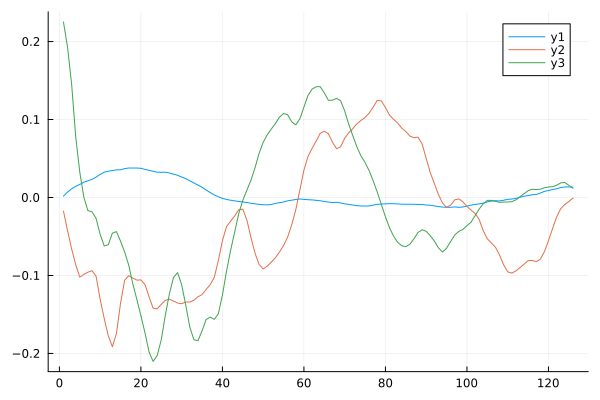

In [27]:
Plots.plot(meanCylUatCyl[:,1,1,1]/mmmm)
Plots.plot!(meanCylUatCyl[:,1,1,2]/mmmm)
Plots.plot!(meanCylUatCyl[:,1,1,3]/mmmm)

In [28]:
cbcspec = readdlm("cbc_spectrum.txt", ' ', Float64, '\n')

20×4 Matrix{Float64}:
  0.15    0.0     0.0     49.7
  0.2   129.0   106.0     92.0
  0.25  230.0   196.0    120.0
  0.3   322.0   195.0    125.0
  0.4   435.0   202.0     98.0
  0.5   457.0   168.0     81.5
  0.7   380.0   127.0     60.2
  1.0   270.0    79.2     39.4
  1.5   168.0    47.8     24.1
  2.0   120.0    34.6     16.5
  2.5    89.0    28.6     12.5
  3.0    70.3    23.1      9.12
  4.0    47.0    14.3      5.62
  6.0    24.7     5.95     1.69
  8.0    12.6     2.23     0.52
 10.0     7.42    0.9      0.161
 12.5     3.96    0.363    0.052
 15.0     2.33    0.162    0.0141
 17.5     1.34    0.066    0.0
 20.0     0.8     0.033    0.0

In [29]:
size(flucSpectrum)

(415, 126)

In [30]:
function EvonKarmanPao(k)
    α = 1.453
    up = 0.25
    ke = 40
    L = 0.746834/ke
    keta = (up^3/L)^0.25*0.0001^(-0.75)

    return @. α*up^2/ke*(k/ke)^4/(1+(k/ke))^(17/6)*exp(-2*(k/keta)^2)
end

EvonKarmanPao (generic function with 1 method)

In [31]:
size(flucSpectrum)

(415, 126)

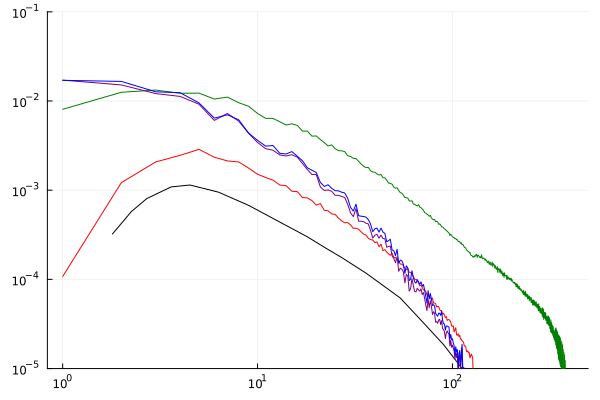

In [58]:
Plots.plot()
xlll = 80:300
Plots.plot(Statistics.mean(flucSpectrum[:,:]./rList',dims=[2])*100,color=:green,legend = false,xscale=:log10,yscale=:log10, ylim=(1e-5,0.1)) # .*(1:415).^(5/3)*0.1
#Plots.plot!(Statistics.mean(flucSpectrum[:,:],dims=[2]),legend = false,xscale=:log10,yscale=:log10, ylim=(1e-5,1))
Plots.plot!(cbcspec[:,1]*9,cbcspec[:,2]/400000,color=:black)
plt = Plots.plot!(uspec*100,color=:red)
plt = Plots.plot!(Statistics.mean(axialFlucSpectrum, dims=[2,3])[:,1,1],color=:purple)
plt = Plots.plot!(Statistics.mean(axialFlucSpectrumOnlyZ, dims=[2,3])[:,1,1],color=:blue)
Plots.plot!(xscale=:log10,yscale=:log10)
Plots.savefig(computationID*"_"*"qVortexTKESpecAverageAlongR.png")
Plots.plot!(xscale=:log10,yscale=:log10)

In [33]:
Statistics.mean(axialFlucSpectrumOnlyZ, dims=[2,3])[:,1,1]

128-element Vector{Float64}:
 0.017059086054530128
 0.016571272078506474
 0.012679555414387299
 0.012385549407532791
 0.009544108636278064
 0.006424310189092249
 0.007000765260808744
 0.006157570572581999
 0.004362779018420922
 0.0036154937024177446
 ⋮
 6.400861139016224e-6
 5.12591866453742e-6
 5.7333964416757054e-6
 3.861769326564065e-6
 3.962550720605119e-6
 2.8280876567691874e-6
 2.6624360629298455e-6
 2.6447840892203343e-6
 3.996011213657765e-6

In [34]:
Plots.plot(movmean(flucSpectrum[:,80],1),color=:blue, alpha=animAlpha(i,size(flucSpectrum)[2]),legend = false,xscale=:log10,yscale=:log10, ylim=(1e-16,10))
plt = Plots.plot!(xlll, 0.001xlll.^(-5/3))

UndefVarError: UndefVarError: `i` not defined

┌ Info: Saved animation to /home/tyhuang/Documents/Github/WaterLily.jl/test/TYTest/SpectrumCal_256_qVortexTKESpecFTLine.gif
└ @ Plots /home/tyhuang/.julia/packages/Plots/3BCH5/src/animation.jl:156


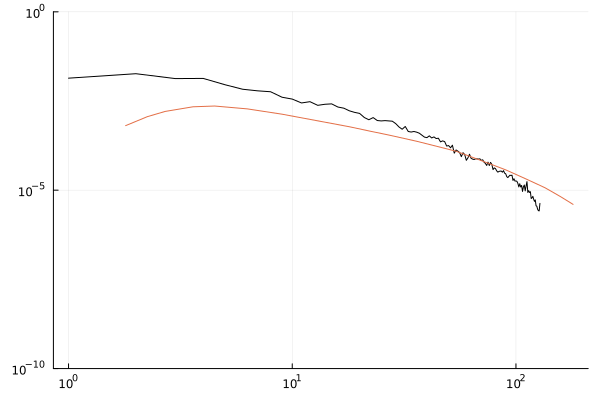

In [35]:
a = Animation()
Plots.plot()
avgAxialFlucSpectrum = Statistics.mean(axialFlucSpectrum, dims=[3])[:,:,1]
for i ∈ 1:cylGridSize[1]
    plt = Plots.plot(movmean(avgAxialFlucSpectrum[:,i].+1e-15,1),color=:black,legend = false,xscale=:log10,yscale=:log10,ylimit=(1e-10,1))
    plt = Plots.plot!(cbcspec[:,1]*9,cbcspec[:,2]/200000)
    frame(a,plt)
end
Plots.plot!(xscale=:log10,yscale=:log10)
gif(a, computationID*"_"*"qVortexTKESpecFTLine.gif")
Plots.plot!()

┌ Info: Saved animation to /home/tyhuang/Documents/Github/WaterLily.jl/test/TYTest/SpectrumCal_256_qVortexTKESpecFTCylSec.gif
└ @ Plots /home/tyhuang/.julia/packages/Plots/3BCH5/src/animation.jl:156


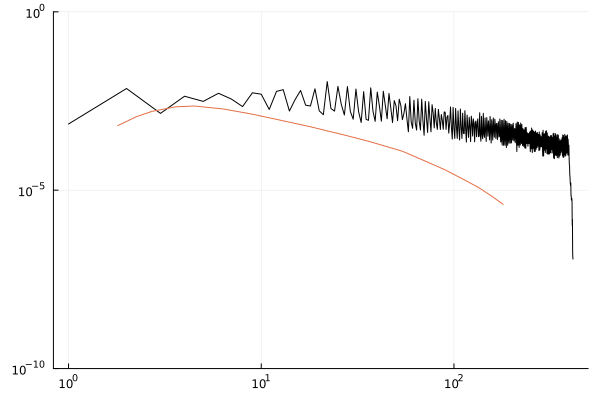

In [36]:
a = Animation() # ./rList[i]
Plots.plot()
for i ∈ 1:cylGridSize[1]
    plt = Plots.plot(movmean(flucSpectrum[:,i].+1e-15,1),color=:black,legend = false,xscale=:log10,yscale=:log10,ylimit=(1e-10,1))
    plt = Plots.plot!(cbcspec[:,1]*9,cbcspec[:,2]/200000)
    frame(a,plt)
end
Plots.plot!(xscale=:log10,yscale=:log10)
gif(a, computationID*"_"*"qVortexTKESpecFTCylSec.gif")
Plots.plot!()

┌ Info: Saved animation to /home/tyhuang/Documents/Github/WaterLily.jl/test/TYTest/SpectrumCal_256_qVortexTKESpecFTCylSecRCorrection.gif
└ @ Plots /home/tyhuang/.julia/packages/Plots/3BCH5/src/animation.jl:156


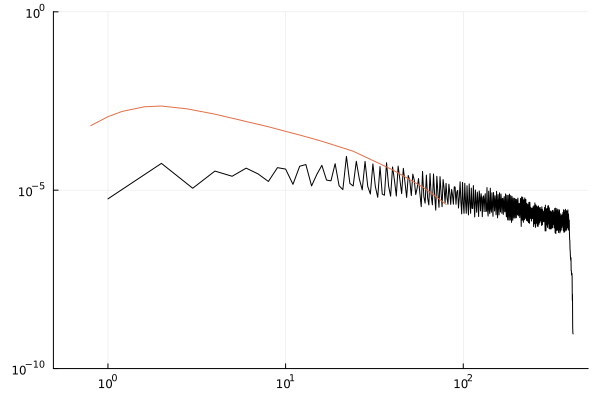

In [37]:
a = Animation() # ./rList[i]
Plots.plot()
for i ∈ 1:cylGridSize[1]
    plt = Plots.plot(movmean(flucSpectrum[:,i]./rList[i] .+1e-15,1),color=:black,legend = false,xscale=:log10,yscale=:log10,ylimit=(1e-10,1))
    plt = Plots.plot!(cbcspec[:,1]*4,cbcspec[:,2]/200000)
    frame(a,plt)
end
Plots.plot!(xscale=:log10,yscale=:log10)
gif(a, computationID*"_"*"qVortexTKESpecFTCylSecRCorrection.gif")
Plots.plot!()

In [38]:
using PyPlot

uu = (uCylAtCyl[:,:,128,1].^2+uCylAtCyl[:,:,128,2].^2).^0.5/4
# uu = flucCylUatCyl[:,:,128,1].*flucCylUatCyl[:,:,128,3]
# uu = ωCylAtCyl[:,:,128,2]
# uu = sqrt.(sum(flucCylUatCyl[:,:,128,:].^2,dims=3))[:,:,1]
# uu = Statistics.mean(flucCylUatCyl[:,:,:,3],dims=3)[:,:,1]
# uu = flucCylUatCyl[:,:,128,3]
# uu = sqrt.(sum(Statistics.mean(flucCylUatCyl[:,:,:,:], dims=3).^2, dims=4))[:,:,1,1]
# uu = log10.(uu)
#uu = Statistics.mean(flucCylUatCyl[:,:,:,:], dims=3)[:,:,1,3]
fig = PyPlot.plt.figure()
ax = fig.add_subplot(111, projection="polar")
pc = PyPlot.plt.contourf(thetaList, rList, uu)
cbar = PyPlot.plt.colorbar(pc)
cbar.set_label("Intensity")
ax[:grid](false)
ax.set_yticklabels([])
PyPlot.plt.savefig("aatt.png")

uu = (uInside[:,:,128,1].^2+uInside[:,:,128,2].^2).^0.5
uu = vortVecInside[:,:,128,3]
pow = 8
fig = PyPlot.plt.figure()
ax = fig.add_subplot(111)
pc = PyPlot.plt.contourf((axes(uu,1))/2^pow, (axes(uu,2))/2^pow, uu'/4)
cbar = PyPlot.plt.colorbar(pc)
cbar.set_label("Intensity")
ax[:grid](false)
PyPlot.plt[:figaspect](1)
PyPlot.plt.savefig("aaaa.png")
matplotlib.pyplot.close()

uu = (uInside[:,:,128,1].^2+uInside[:,:,128,2].^2).^0.5
uu = vortVecInside[:,:,128,3]
uu = uvw[:,:,128,3]
pow = 8
fig = PyPlot.plt.figure()
ax = fig.add_subplot(111)
pc = PyPlot.plt.contourf((axes(uu,1))/2^pow, (axes(uu,2))/2^pow, uu'/4)
cbar = PyPlot.plt.colorbar(pc)
cbar.set_label("Intensity")
ax[:grid](false)
PyPlot.plt[:figaspect](1)
PyPlot.plt.savefig("aaaatttt.png")
matplotlib.pyplot.close()

In [39]:
matplotlib.pyplot.close()

In [40]:
println(minimum(uCarteAtCyl[:,:,1,3]))
println(minimum(uu))

println(maximum(uCarteAtCyl[:,:,1,3]))
println(maximum(uu))

-2.9483613831341042
-0.9657772459765674
3.0067591696429807
0.9801198004003706


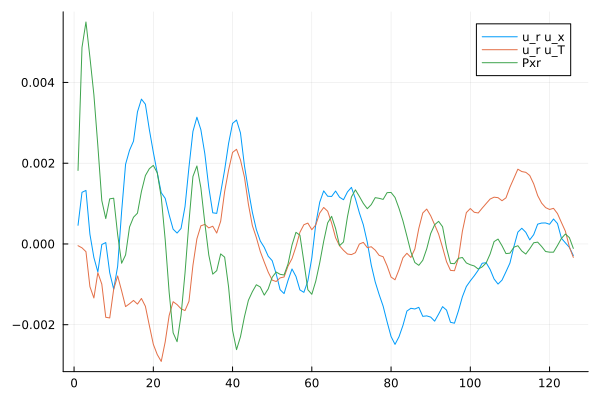

In [41]:
uruxAlongR = Statistics.mean(flucCylUatCyl[:,:,:,1].*flucCylUatCyl[:,:,:,3],dims=[2,3])
uruTAlongR = Statistics.mean(flucCylUatCyl[:,:,:,1].*flucCylUatCyl[:,:,:,2],dims=[2,3])
PuxurAlongR = meanCylωatCyl[:,:,:,2]/2 .*(Statistics.mean(flucCylUatCyl[:,:,:,1].^2,dims=[2,3])+Statistics.mean(flucCylUatCyl[:,:,:,3].^2,dims=[2,3]))

Plots.plot(uruxAlongR[:,1,1],label="u_r u_x")#uCylAtCyl #meanCylUatCyl
Plots.plot!(uruTAlongR[:,1,1],label="u_r u_T")
Plots.plot!(PuxurAlongR[:,1,1],label="Pxr")

In [42]:
size(flucCylUatCyl)

(126, 256, 256, 3)

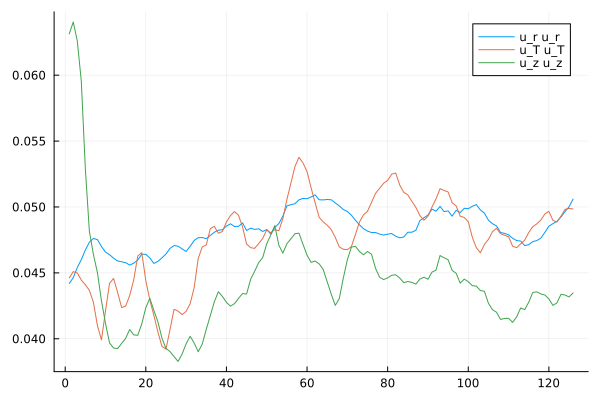

In [43]:
ururAlongR = Statistics.mean(flucCylUatCyl[:,:,:,1].^2,dims=[2,3])
ututAlongR = Statistics.mean(flucCylUatCyl[:,:,:,2].^2,dims=[2,3])
uzuzAlongR = Statistics.mean(flucCylUatCyl[:,:,:,3].^2,dims=[2,3])
Plots.plot(ururAlongR[:,1,1],label="u_r u_r")
Plots.plot!(ututAlongR[:,1,1],label="u_T u_T")
Plots.plot!(uzuzAlongR[:,1,1],label="u_z u_z")

In [44]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    Plots.plot!(rListDimLess, uMeanAxialList[:,i],color=:blue, alpha=animAlpha(i,numFiles),legend = false,ylimit=(-0.1,1.1))
    Plots.plot!(rListDimLess, uMeanAzimuthalList[:,i],color=:red, alpha=animAlpha(i,numFiles),legend = false)
    plt = Plots.plot!(rListDimLess, uMeanRadialList[:,i],color=:green, alpha=animAlpha(i,numFiles),legend = false)
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_velocityProfiles.png")
Plots.plot!()
gif(a,computationID*"_"*"qVortex_velocityProfiles.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [45]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    Plots.plot(rListDimLess, uuAlongRList[:,1,i],color=:blue,ylimit=(0,0.0401),label="urur")
    Plots.plot!(rListDimLess, uuAlongRList[:,2,i],color=:red,ylimit=(0,0.0401),label="utut")
    plt = Plots.plot!(rListDimLess, uuAlongRList[:,3,i],color=:green,ylimit=(0,0.0401),label="uzuz")
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_uuDiag.png")
Plots.plot!()
gif(a,computationID*"_"*"qVortex_uuDiag.gif")


UndefVarError: UndefVarError: `numFiles` not defined

In [46]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    Plots.plot!(rListDimLess, PAlongRList[:,1,i],color=:blue, alpha=animAlpha(i,numFiles),legend = false,ylimit=(-0.03,0.01))
    plt = Plots.plot!(rListDimLess, uuAlongRList[:,6,i],color=:red, alpha=animAlpha(i,numFiles),legend = false)
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_uruz.png")
Plots.plot!()
gif(a,computationID*"_"*"qVortex_uruz.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [47]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    plt = Plots.plot!(rListDimLess, uuAlongRList[:,4,i],color=:blue, alpha=animAlpha(i,numFiles),legend = false,ylimit=(-0.004,0.006))
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_urut.png")
Plots.plot!()
gif(a,computationID*"_"*"qVortex_urut.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [48]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    Plots.plot!(rListDimLess, ωMeanAxialList[:,i],color=:blue, alpha=animAlpha(i,numFiles),legend = false,ylimit=(-2,6))
    Plots.plot!(rListDimLess, ωMeanAzimuthalList[:,i],color=:red, alpha=animAlpha(i,numFiles),legend = false)
    plt = Plots.plot!(rListDimLess, ωMeanRadialList[:,i],color=:green, alpha=animAlpha(i,numFiles),legend = false)
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_vorticityProfiles.png")
Plots.plot!()
gif(a,computationID*"_"*"qVortex_vorticityProfiles.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [49]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    plt = Plots.plot!(rListDimLess,tkeRList[:,i],color=:blue, alpha=animAlpha(i,numFiles),legend = false,ylimit=(0,0.7))
    frame(a,plt)
end
Plots.plot!()
Plots.savefig(computationID*"_"*"qVortex_tkeYProfiles.png")

gif(a,computationID*"_"*"qVortex_tkeYProfiles.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [50]:
Plots.plot!(rListDimLess, uMeanAxialList[:,i],color=:blue, alpha=animAlpha(i,numFiles),legend = false,ylimit=(-0.1,1.1))
Plots.plot!(rListDimLess, uMeanAzimuthalList[:,i],color=:red, alpha=animAlpha(i,numFiles),legend = false)
plt = Plots.plot!(rListDimLess, uMeanRadialList[:,i],color=:green, alpha=animAlpha(i,numFiles),legend = false)
frame(a,plt)

UndefVarError: UndefVarError: `uMeanAxialList` not defined

In [51]:
maximum(tkePlane)

UndefVarError: UndefVarError: `tkePlane` not defined

In [52]:
explist = 15:20
expVal = exp.(explist*0.6*0.446 .- 12.0)
Plots.plot(timeListDimLess[1:end-1], tkeList[1:end],yscale=:log10,xlimit=(0,maximum(timeListDimLess)),legend=false,ylimit=(1e-6,1e-2),color=:blue,linewidth=1.5)
Plots.plot!(explist, expVal,yscale=:log10,xlimit=(0,maximum(timeListDimLess)),legend=false)
Plots.savefig(computationID*"_"*"qVortex_TKEEvolutions.png")
Plots.plot!()

UndefVarError: UndefVarError: `timeListDimLess` not defined

In [53]:
Plots.plot(timeListDimLess[1:end-1], axiMomList[1:end],xlimit=(0,maximum(timeListDimLess)),legend=false,color=:blue,linewidth=1.5)

UndefVarError: UndefVarError: `timeListDimLess` not defined

In [54]:
a = Animation()
Plots.plot()
for i in 1:numFiles
    plt =  Plots.plot!(kList,vortSpectrumList[:,i],color=:blue, alpha=animAlpha(i,numFiles),xscale=:log10,yscale=:log10,legend = false,ylimit=(1e-9,1))
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_Enstrophy.png")
Plots.plot!()

gif(a,computationID*"_"*"qVortex_Enstrophy.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [55]:
a = Animation()
Plots.plot()
xlll = 20:80
Plots.plot!(xlll, 0.001xlll.^(-5/3))
for i in 1:numFiles
    plt =  Plots.plot!(kList,flucSpectrumList[:,i],color=:blue, alpha=animAlpha(i,numFiles),xscale=:log10,yscale=:log10,legend=false, ylimit=(1e-9,2e-3), yticks = 10. .^(-9:3:-3))
    frame(a,plt)
end
Plots.plot!(legend = false)
Plots.savefig(computationID*"_"*"qVortex_TKESpec.png")
Plots.plot!()

gif(a,computationID*"_"*"qVortex_TKESpec.gif")

UndefVarError: UndefVarError: `numFiles` not defined

In [56]:
# # processing the velocity data
# ComputeVorticity!(uOriginAll, vortVec)
# vortVec *= TScale
# # vorticityMag = sqrt.(dropdims(sum(vortVec.^2, dims=4), dims=4))
# # ComputeEntrophySpectrum!(vortVec[2:end-1,2:end-1,2:end-1,:], vortSpectrum)
# # vortSpectrum *= 2pi*(2pi*LScale/gridSize[1])
# StaggerToCollocateVel!(uOriginAll, uInside)
# ToCylindricalVel!(uInside, uCyl, rMat, CosThetaMat, SinThetaMat)
# InterpolCylU!(uInside, uCylAtCyl, xCylAtCyl)
# meanCylUatCyl = Statistics.mean(uCylAtCyl, dims=[2,3])
# flucCylUatCyl = uCylAtCyl .- meanCylUatCyl
# # ComputeMeanU!(uCyl, uMeanRadial, uMeanAzimuthal, uMeanAxial, rMat, rGaussianMat)
# ComputeSpectrumFromCylindrical!(flucCylUatCyl, rList, gridSize[3], flucSpectrum)
# # ProjectCylMeanToCartesian!(uMeanFromCyl, uMeanRadial, uMeanAzimuthal, uMeanAxial, rMat, rGaussianMat)
# # ComputeFluc!(uMeanFromCyl, uCyl, uFluc)
# # ComputeEntrophySpectrum!(uFluc, flucSpectrum)
# flucSpectrum *= 2pi*(2pi*LScale/gridSize[1])
# # tkePlane = ComputePlanarTKE!(uFluc)
# # # compute kinetic energy
# # tke = 0.5*sum(uFluc.^2)/prod(gridSize)
# # mke = 0.5*sum(uMeanFromCyl.^2)*gridSize[3]/prod(gridSize)

┌ Info: Saved animation to /tmp/jl_JabyBUbWJS.gif
└ @ Plots /home/tyhuang/.julia/packages/Plots/3BCH5/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_JabyBUbWJS.gif")
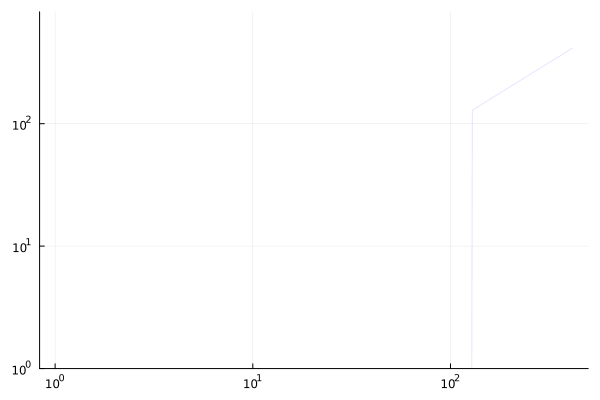

In [57]:
a = Animation()
Plots.plot()
for i ∈ 1:size(flucSpectrum)[2]
    plt = Plots.plot!(counts[:,i],color=:blue, alpha=animAlpha(i,size(flucSpectrum)[2]),legend = false,yscale=:log10,xscale=:log10, ylim=(1,820))
    frame(a,plt)
end
Plots.plot!(yscale=:log10,xscale=:log10)
gif(a)